<a href="https://colab.research.google.com/github/Mezirix/AIDA-Saskpoly/blob/main/Copy_of_Capstone_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Group members:





*   Idongesit Utah
*   Evelyn Emoedume

*   Christiantus Anyanwu









# **Importing the neccessary Libraries**

In [ ]:
!pip install pillow


In [ ]:
import pandas as pd
import numpy as np
import tensorflow as tf
import seaborn as sns
from tensorflow.python.client import device_lib
device_lib.list_local_devices()
import os
from tensorflow.keras.utils import image_dataset_from_directory
from matplotlib import pyplot as plt
import seaborn as sns
%matplotlib inline
import math
from tensorflow import keras
from tensorflow.keras import layers
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow.keras import layers
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.preprocessing import StandardScaler
from PIL import Image, ImageEnhance
import random
import cv2
from sklearn.preprocessing import MultiLabelBinarizer
from tqdm import tqdm
from tensorflow.keras.utils import plot_model
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.callbacks import TensorBoard
import tensorflow_hub as hub
from sklearn.metrics import classification_report, confusion_matrix
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import Model
from tensorflow.keras.models import load_model
import matplotlib.image as mpimg
from tensorflow.keras import layers
# This is an additional libraries incase
!pip install matplotlib opencv-python
import warnings
warnings.filterwarnings('ignore')




## Mounting Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Listing out the contents of the capstone folder and creating the file paths/directories

In [ ]:
# List the contents of the Capstone Data folder
!ls /content/drive/Shareddrives/Capstone/


Capstone  CapstoneNewData


In [ ]:

!ls /content/drive/Shareddrives/Capstone/CapstoneNewData/


 Apple	        capstonedata.zip  'Corn (Maize)'   Peach    Strawberry
'Bell Pepper'   Cherry		   Grape	   Potato   Tomato


In [ ]:
# !unzip '/content/drive/Shareddrives/Capstone/CapstoneNewData/capstonedata.zip' -d '/content/drive/Shareddrives/Capstone/CapstoneNewData/'

In [ ]:
!ls /content/drive/Shareddrives/Capstone/CapstoneNewData/

 Apple	        capstonedata.zip  'Corn (Maize)'   Peach    Strawberry
'Bell Pepper'   Cherry		   Grape	   Potato   Tomato


In [ ]:
!ls /content/drive/Shareddrives/Capstone/CapstoneNewData/Apple/



test  Test  train  Train  val  Val


In [ ]:
!ls /content/drive/Shareddrives/Capstone/CapstoneNewData/Apple/Test/


'Apple Scab'  'Black Rot'  'Cedar Apple Rust'   Healthy


# EXPLORATORY DATA ANALYSIS/ DATA PREPROCESSING

This code block classifies all the plant types and diseases

In [ ]:
# List of all plant names
plants = ['Apple', 'Bell Pepper', 'Cherry', 'Corn (Maize)', 'Grape', 'Peach', 'Potato', 'Strawberry', 'Tomato']

# Initialize a dictionary to store classes for each plant
classes = {}

# Base directory where all plant data is stored
base_dir = '/content/drive/Shareddrives/Capstone/CapstoneNewData/'

# Iterate through each plant to extract class names
for plant in plants:
    # Define directory paths for train, validation, and test sets
    train_dir = os.path.join(base_dir, plant, 'Train')
    val_dir = os.path.join(base_dir, plant, 'Val')
    test_dir = os.path.join(base_dir, plant, 'Test')


    print("\n")

    # Ensure the train directory exists
    if not os.path.isdir(train_dir):
        print(f"Error: Train directory for {plant} does not exist at {train_dir}")
        continue

    # Retrieve class names by listing subdirectories in the train directory
    class_names = [d for d in os.listdir(train_dir) if os.path.isdir(os.path.join(train_dir, d))]

    # Initialize the list for the current plant in the classes dictionary
    classes[plant] = []

    print(f">>> Classes in {plant} dataset :-")
    for num, cat in enumerate(class_names, start=1):
        classes[plant].append(cat)
        print(num, cat)
    print("\n")

    # count the number of images per class
    for cat in class_names:
      num_images = len(os.listdir(os.path.join(train_dir, cat)))
    print(f"Class '{cat}' contains {num_images} images")





>>> Classes in Apple dataset :-
1 Apple Scab
2 Black Rot
3 Cedar Apple Rust
4 Healthy


Class 'Healthy' contains 2008 images


>>> Classes in Bell Pepper dataset :-
1 Bacterial Spot
2 Healthy


Class 'Healthy' contains 1988 images


>>> Classes in Cherry dataset :-
1 Healthy
2 Powdery Mildew


Class 'Powdery Mildew' contains 1683 images


>>> Classes in Corn (Maize) dataset :-
1 Cercospora Leaf Spot
2 Common Rust 
3 Healthy
4 Northern Leaf Blight


Class 'Northern Leaf Blight' contains 1908 images


>>> Classes in Grape dataset :-
1 Black Rot
2 Esca (Black Measles)
3 Healthy
4 Leaf Blight


Class 'Leaf Blight' contains 1722 images


>>> Classes in Peach dataset :-
1 Bacterial Spot
2 Healthy


Class 'Healthy' contains 1728 images


>>> Classes in Potato dataset :-
1 Early Blight
2 Healthy
3 Late Blight


Class 'Late Blight' contains 1939 images


>>> Classes in Strawberry dataset :-
1 Healthy
2 Leaf Scorch


Class 'Leaf Scorch' contains 1774 images


>>> Classes in Tomato dataset :-
1

This code block defines directory paths for each plant, extracts class names for each plant dataset, creates data generators for training, validation, and testing, and plots sample images from each plant's training set to verify that the data is correctly prepared and organized.

Train directory for Apple: /content/drive/Shareddrives/Capstone/CapstoneNewData/Apple/Train
Validation directory for Apple: /content/drive/Shareddrives/Capstone/CapstoneNewData/Apple/Val
Test directory for Apple: /content/drive/Shareddrives/Capstone/CapstoneNewData/Apple/Test


Train directory for Bell Pepper: /content/drive/Shareddrives/Capstone/CapstoneNewData/Bell Pepper/Train
Validation directory for Bell Pepper: /content/drive/Shareddrives/Capstone/CapstoneNewData/Bell Pepper/Val
Test directory for Bell Pepper: /content/drive/Shareddrives/Capstone/CapstoneNewData/Bell Pepper/Test


Train directory for Cherry: /content/drive/Shareddrives/Capstone/CapstoneNewData/Cherry/Train
Validation directory for Cherry: /content/drive/Shareddrives/Capstone/CapstoneNewData/Cherry/Val
Test directory for Cherry: /content/drive/Shareddrives/Capstone/CapstoneNewData/Cherry/Test


Train directory for Corn (Maize): /content/drive/Shareddrives/Capstone/CapstoneNewData/Corn (Maize)/Train
Validation dire

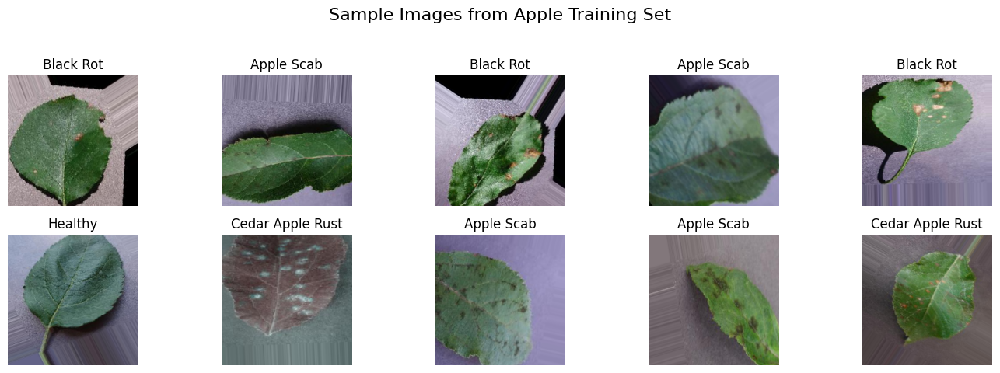




>>>> Sample Images of "Bell Pepper" dataset


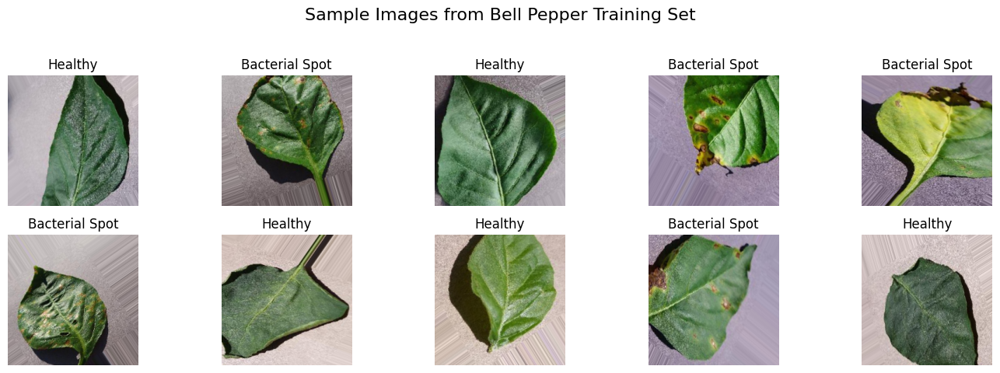




>>>> Sample Images of "Cherry" dataset


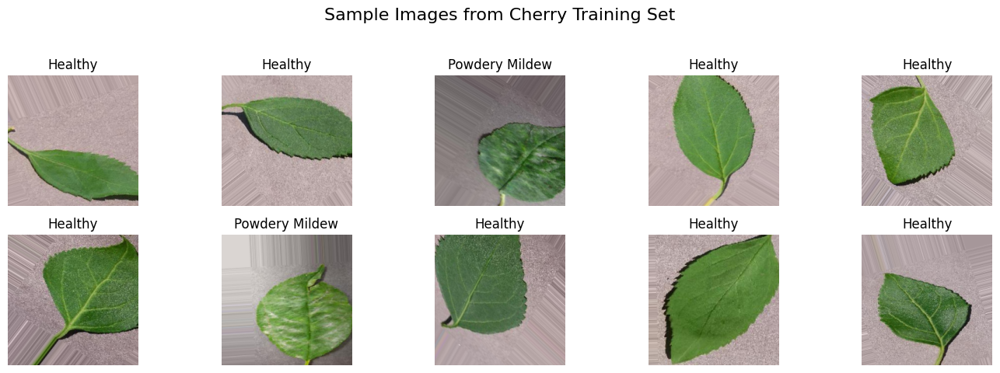




>>>> Sample Images of "Corn (Maize)" dataset


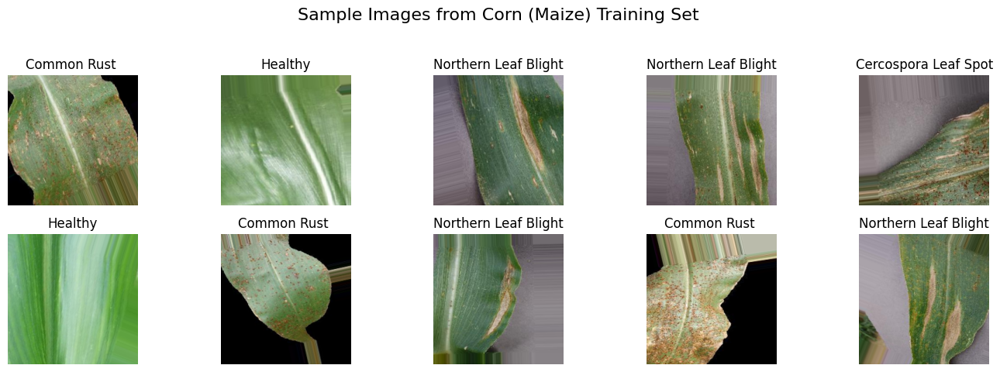




>>>> Sample Images of "Grape" dataset


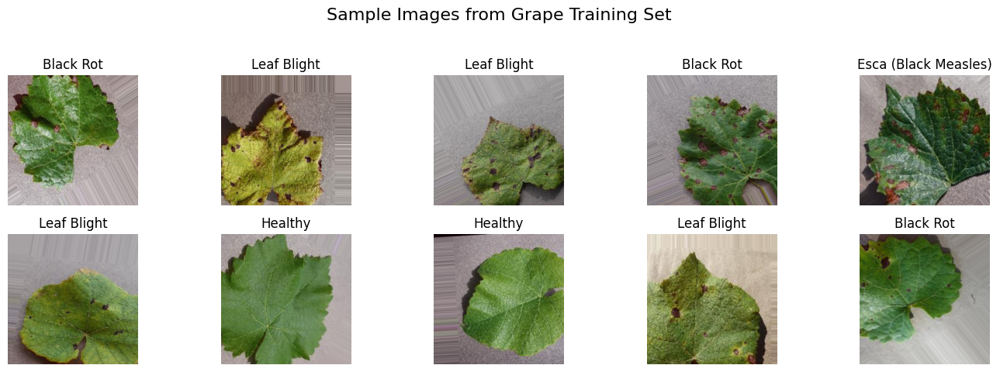




>>>> Sample Images of "Peach" dataset


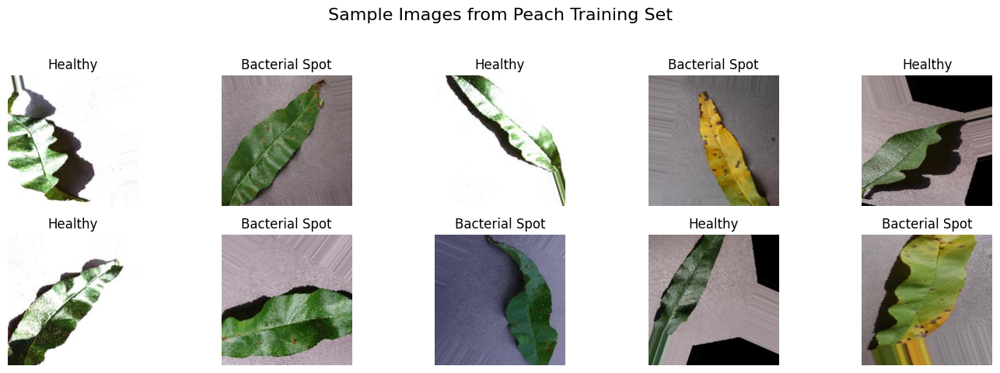




>>>> Sample Images of "Potato" dataset


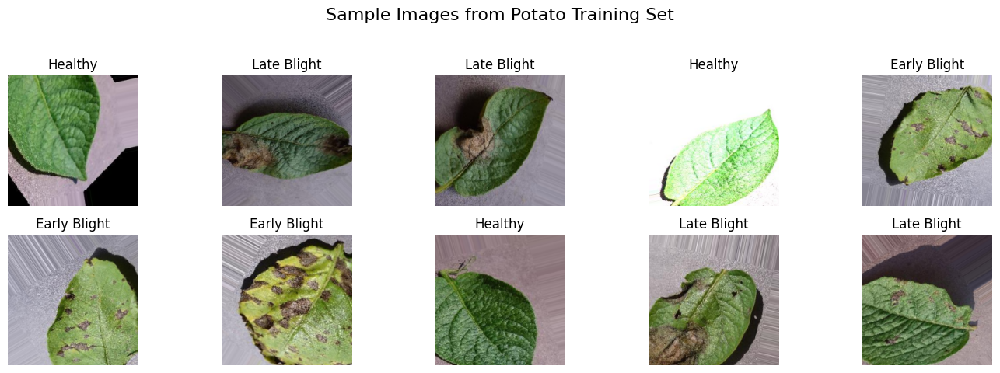




>>>> Sample Images of "Strawberry" dataset


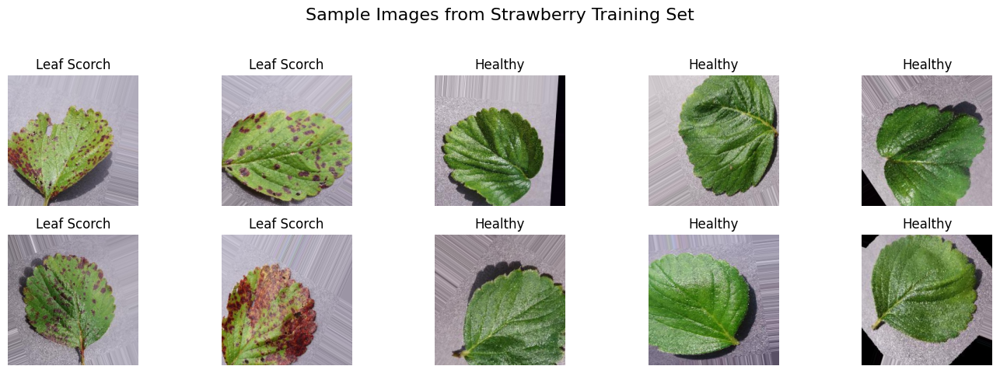




>>>> Sample Images of "Tomato" dataset


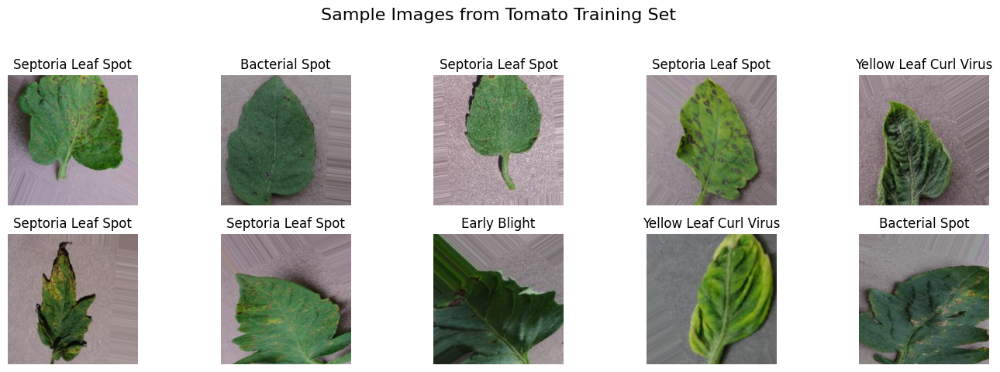

In [ ]:
# Define Plant Names and Directory Paths
plants = ['Apple', 'Bell Pepper', 'Cherry', 'Corn (Maize)', 'Grape', 'Peach', 'Potato', 'Strawberry', 'Tomato']
base_dir = '/content/drive/Shareddrives/Capstone/CapstoneNewData/'

plant_dirs = {}
for plant in plants:
    train_dir = os.path.join(base_dir, plant, 'Train')
    val_dir = os.path.join(base_dir, plant, 'Val')
    test_dir = os.path.join(base_dir, plant, 'Test')

    plant_dirs[plant] = {
        'train': train_dir,
        'val': val_dir,
        'test': test_dir
    }

    print(f"Train directory for {plant}: {train_dir}")
    print(f"Validation directory for {plant}: {val_dir}")
    print(f"Test directory for {plant}: {test_dir}")
    print("\n")

# Extract Class Names and Populate 'classes' Dictionary
classes = {}
for plant in plants:
    train_dir = plant_dirs[plant]['train']

    if not os.path.isdir(train_dir):
        print(f"Error: Train directory for {plant} does not exist at {train_dir}")
        continue

    class_names = [d for d in os.listdir(train_dir) if os.path.isdir(os.path.join(train_dir, d))]
    classes[plant] = class_names

    print(f">>> Classes in {plant} dataset :-")
    for num, cat in enumerate(class_names, start=1):
        print(num, cat)
    print("\n")

# Create Data Generators and Populate 'data_generators' Dictionary
data_generators = {}
for plant in plants:
    train_dir = plant_dirs[plant]['train']
    val_dir = plant_dirs[plant]['val']
    test_dir = plant_dirs[plant]['test']

    if not os.path.isdir(train_dir):
        print(f"Skipping {plant} as train directory does not exist.")
        continue

    # Applies augmentation transformations
    train_datagen = ImageDataGenerator(
        rescale=1./255,
        rotation_range=40,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest'
    )

    val_datagen = ImageDataGenerator(rescale=1./255)
    test_datagen = ImageDataGenerator(rescale=1./255)

    train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(224, 224),
        batch_size=32,
        class_mode='categorical',
        shuffle=True
    )

    validation_generator = val_datagen.flow_from_directory(
        val_dir,
        target_size=(224, 224),
        batch_size=32,
        class_mode='categorical',
        shuffle=True
    )

    test_generator = test_datagen.flow_from_directory(
        test_dir,
        target_size=(224, 224),
        batch_size=32,
        class_mode='categorical',
        shuffle=False
    )

    data_generators[plant] = {
        'train': train_generator,
        'validation': validation_generator,
        'test': test_generator
    }

    print(f"Data generators created for {plant}")

# Verify 'classes' and 'data_generators'
print("Classes Dictionary:")
for plant, class_list in classes.items():
    print(f"{plant}: {class_list}")
print("\n")

print("Data Generators Dictionary Keys:")
print(data_generators.keys())
print("\n")

# Plot Sample Images
for plant in plants:
    if plant not in data_generators:
        print(f"No data generators found for {plant}. Skipping...")
        continue

    print(f'>>>> Sample Images of "{plant}" dataset')
    plt.figure(figsize=(14, 5))

    train_generator = data_generators[plant]['train']
    image_batch, image_label = next(train_generator)

    for i in range(10):
        plt.subplot(2, 5, i+1)
        plt.imshow(image_batch[i])

        if image_label.shape[-1] > 1:
            class_index = np.argmax(image_label[i])
        else:
            class_index = image_label[i]

        class_name = classes[plant][class_index]

        plt.title(class_name)
        plt.axis('off')

    plt.suptitle(f'Sample Images from {plant} Training Set', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()
    print("\n\n")


This code block was a step we took in preparing the data for training and evaluation. We efficiently loads and preprocesses images while allowing for augmentation if needed, we were trying to improve the model's performance.

In [ ]:
# Define paths to the main directories for training, validation, and testing
base_dir = '/content/drive/Shareddrives/Capstone/CapstoneNewData/'

# Initialize the ImageDataGenerator for normalization and augmentation if needed
train_datagen = ImageDataGenerator(rescale=1./255)  # Rescaling pixel values
val_datagen = ImageDataGenerator(rescale=1./255)    # Rescaling pixel values
test_datagen = ImageDataGenerator(rescale=1./255)   # Rescaling pixel values

# Create datasets for each plant
train_datasets = {}
val_datasets = {}
test_datasets = {}

for plant in plants:
    train_dir = f'{base_dir}{plant}/Train/'
    val_dir = f'{base_dir}{plant}/Val/'
    test_dir = f'{base_dir}{plant}/Test/'

    # Load the training dataset
    train_datasets[plant] = train_datagen.flow_from_directory(
        train_dir,
        target_size=(256, 256),  # Adjust based on your image size
        batch_size=32,
        class_mode='categorical'  # Change to 'binary' if only two classes
    )

    # Load the validation dataset
    val_datasets[plant] = val_datagen.flow_from_directory(
        val_dir,
        target_size=(256, 256),
        batch_size=32,
        class_mode='categorical'
    )

    # Load the test dataset
    test_datasets[plant] = test_datagen.flow_from_directory(
        test_dir,
        target_size=(256, 256),
        batch_size=32,
        class_mode='categorical'
    )

    print(f"Loaded datasets for {plant}:\n  Train: {train_datasets[plant].n} images\n  Validation: {val_datasets[plant].n} images\n  Test: {test_datasets[plant].n} images\n")


Found 7771 images belonging to 4 classes.
Found 1747 images belonging to 4 classes.
Found 196 images belonging to 4 classes.
Loaded datasets for Apple:
  Train: 7771 images
  Validation: 1747 images
  Test: 196 images

Found 3901 images belonging to 2 classes.
Found 877 images belonging to 2 classes.
Found 98 images belonging to 2 classes.
Loaded datasets for Bell Pepper:
  Train: 3901 images
  Validation: 877 images
  Test: 98 images

Found 3509 images belonging to 2 classes.
Found 788 images belonging to 2 classes.
Found 89 images belonging to 2 classes.
Loaded datasets for Cherry:
  Train: 3509 images
  Validation: 788 images
  Test: 89 images

Found 7316 images belonging to 4 classes.
Found 1645 images belonging to 4 classes.
Found 188 images belonging to 4 classes.
Loaded datasets for Corn (Maize):
  Train: 7316 images
  Validation: 1645 images
  Test: 188 images

Found 7222 images belonging to 4 classes.
Found 1623 images belonging to 4 classes.
Found 182 images belonging to 4 cl

#This code block focuses on creating data generators for each plant, standardizing images, and visualizing both the original and standardized images

Found 7771 images belonging to 4 classes.
Found 3901 images belonging to 2 classes.
Found 3509 images belonging to 2 classes.
Found 7316 images belonging to 4 classes.
Found 7222 images belonging to 4 classes.
Found 3566 images belonging to 2 classes.
Found 5702 images belonging to 3 classes.
Found 3598 images belonging to 2 classes.
Found 11108 images belonging to 6 classes.
>>>> Sample Images of "Apple" dataset


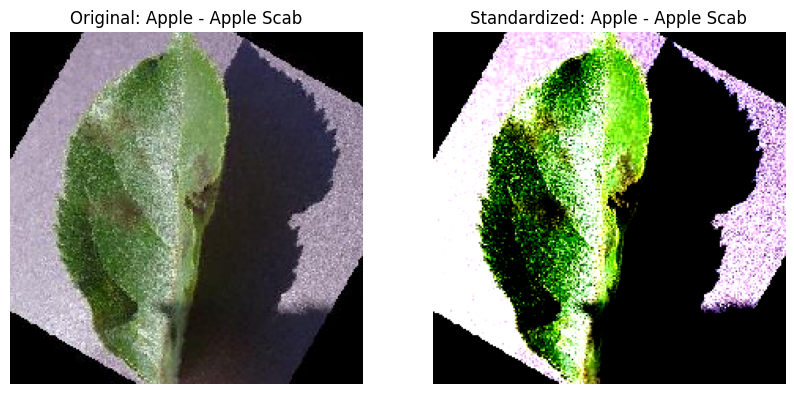

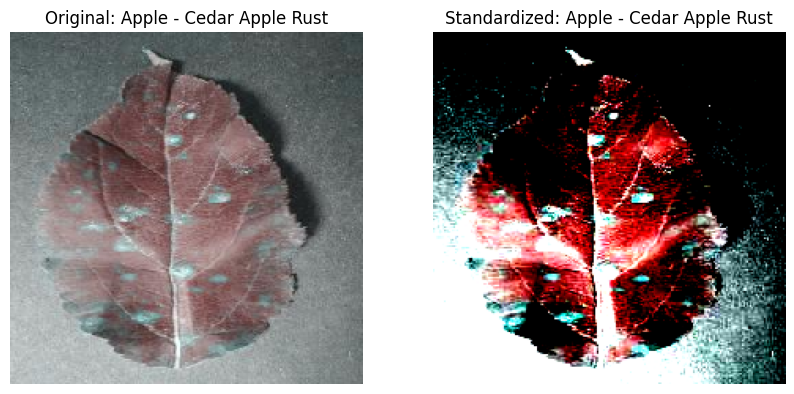

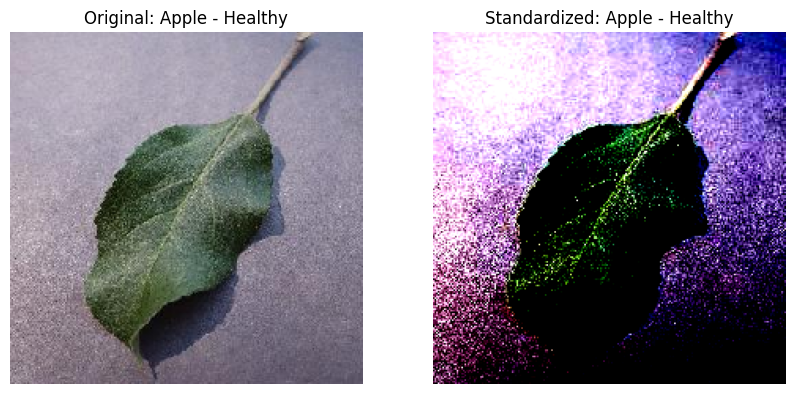

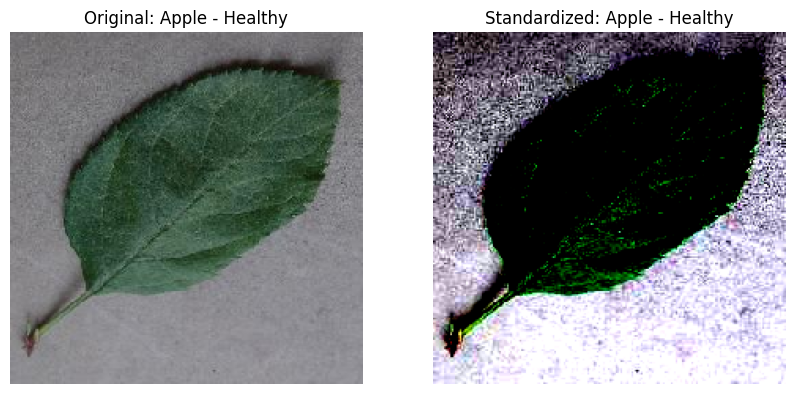

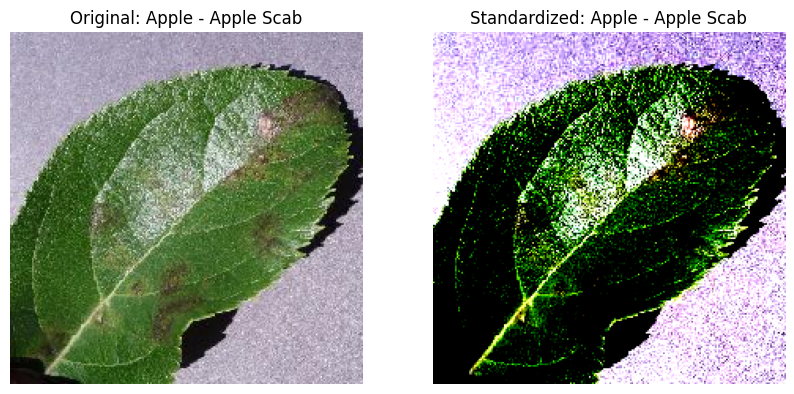

>>>> Sample Images of "Bell Pepper" dataset


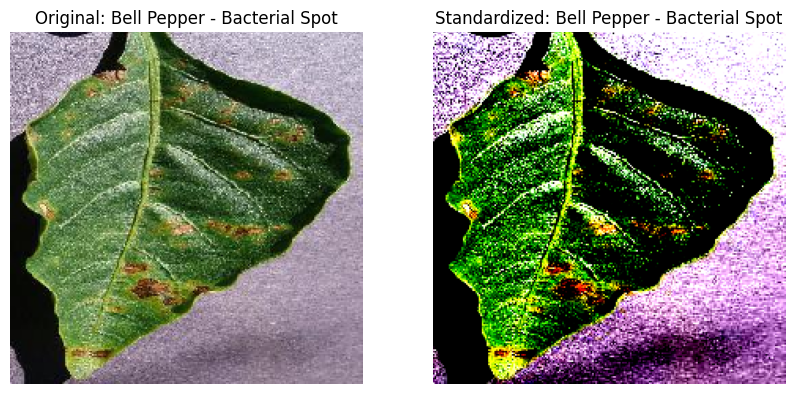

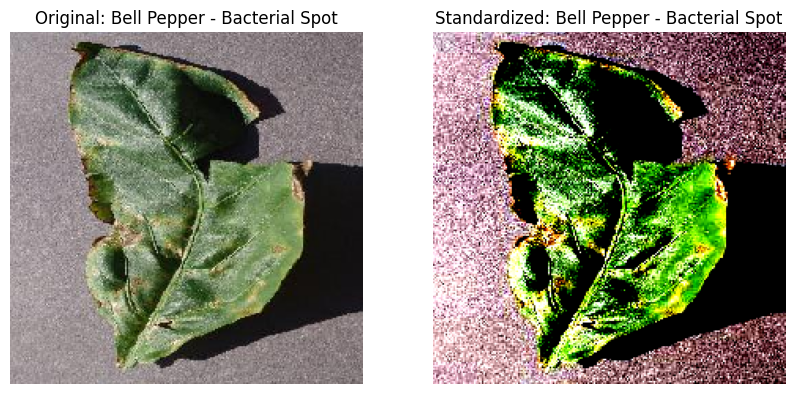

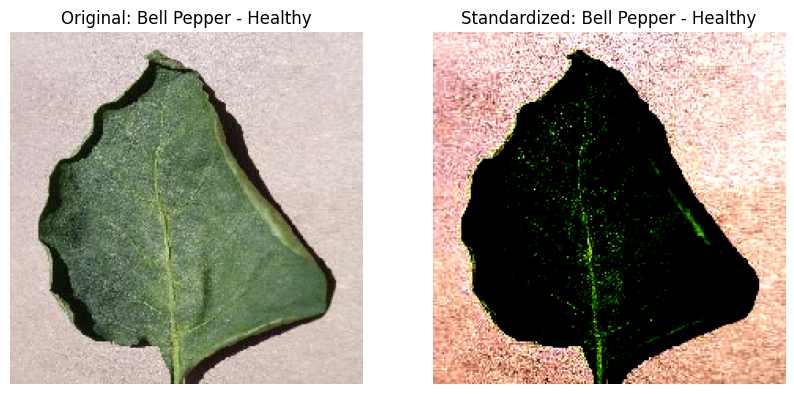

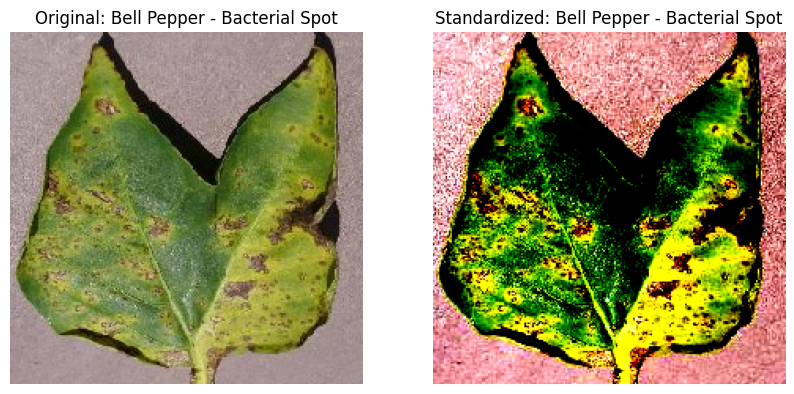

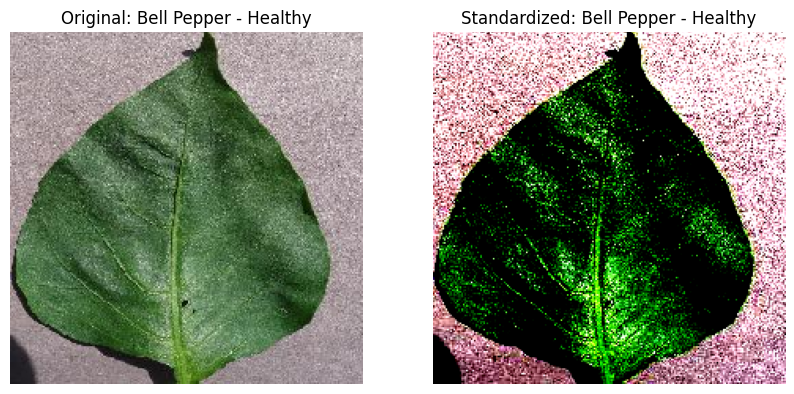

>>>> Sample Images of "Cherry" dataset


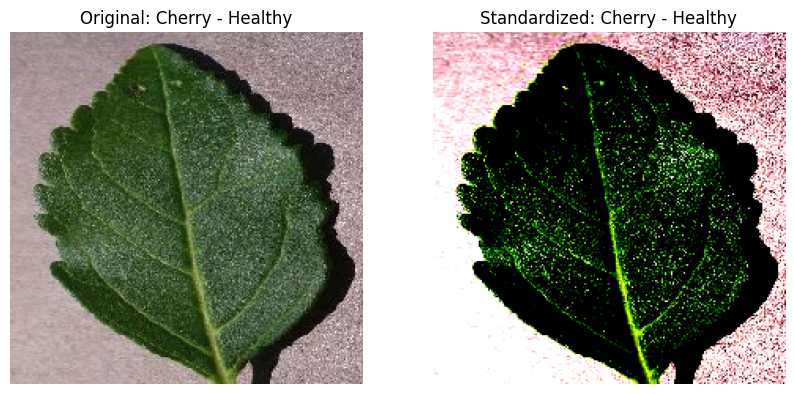

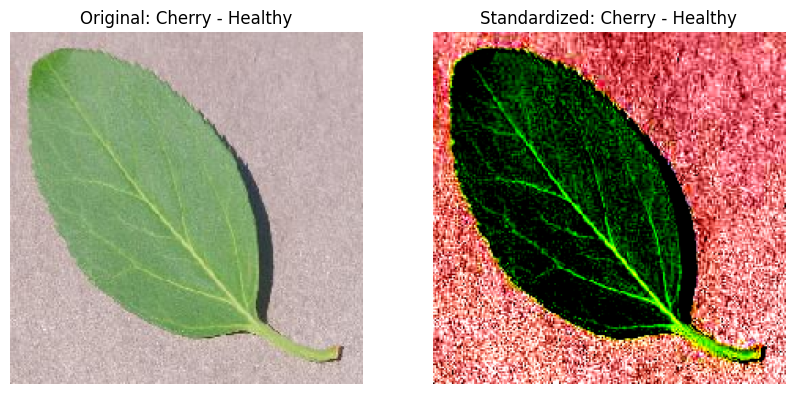

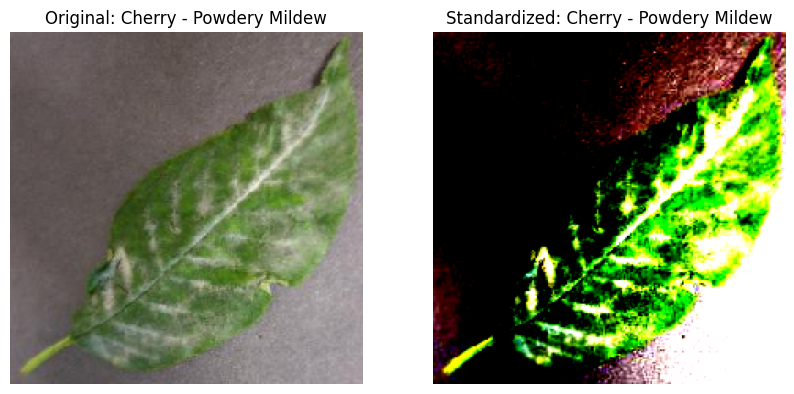

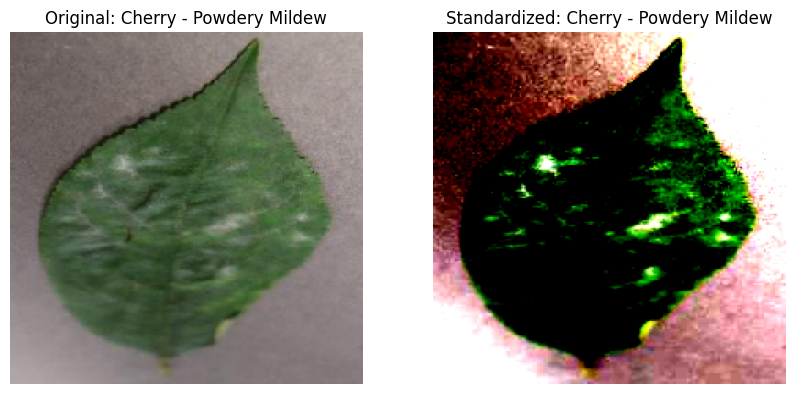

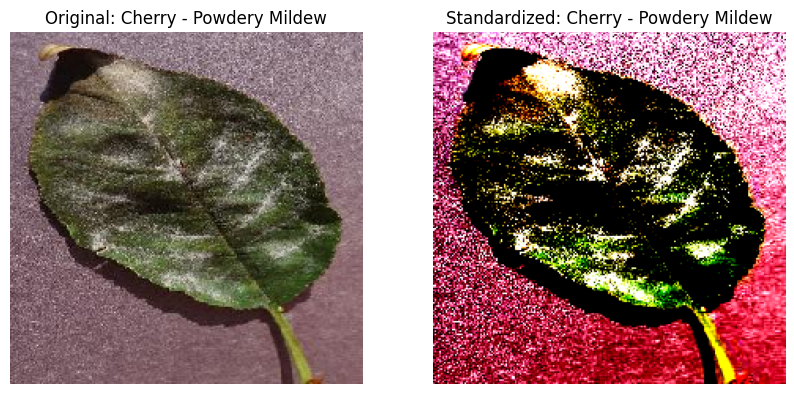

>>>> Sample Images of "Corn (Maize)" dataset


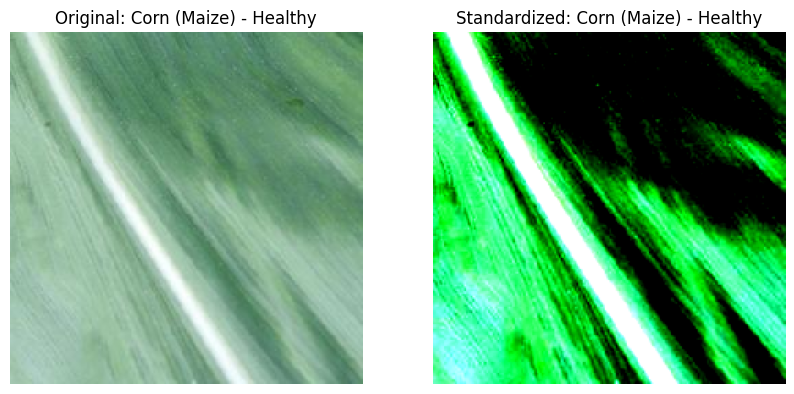

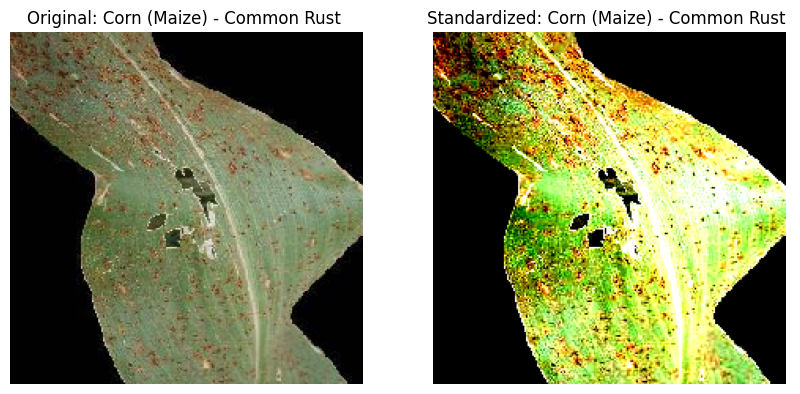

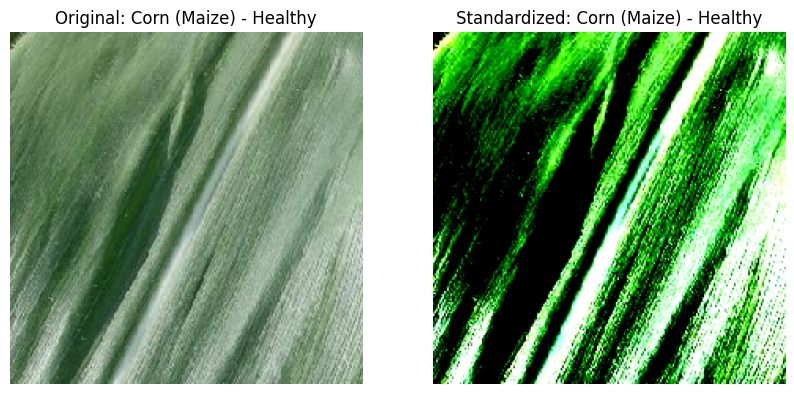

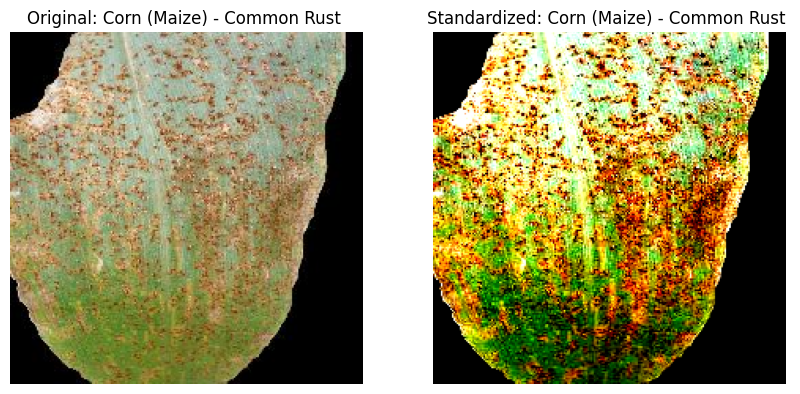

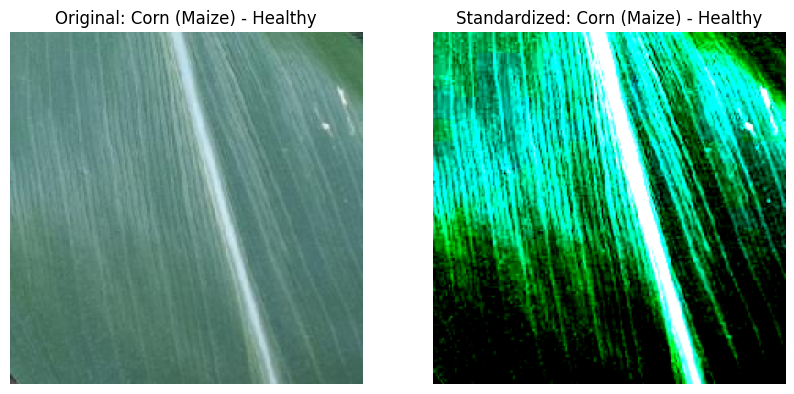

>>>> Sample Images of "Grape" dataset


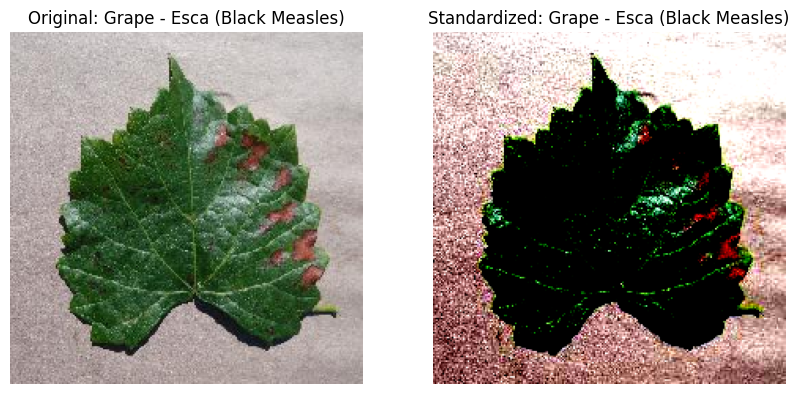

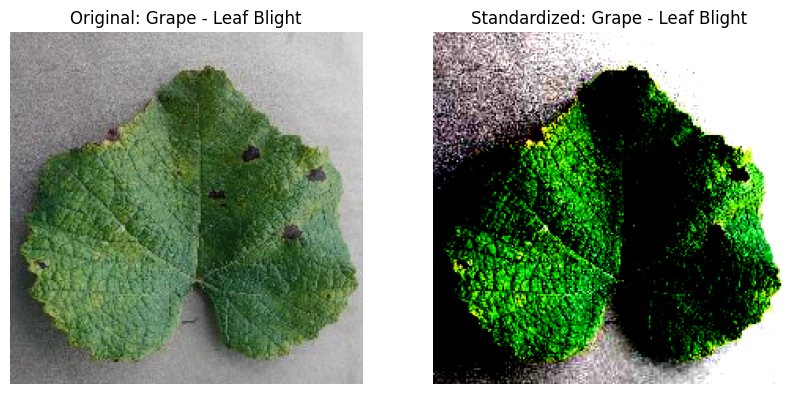

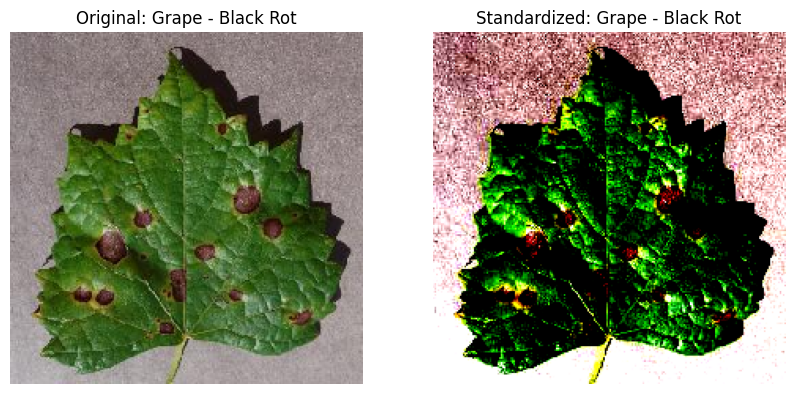

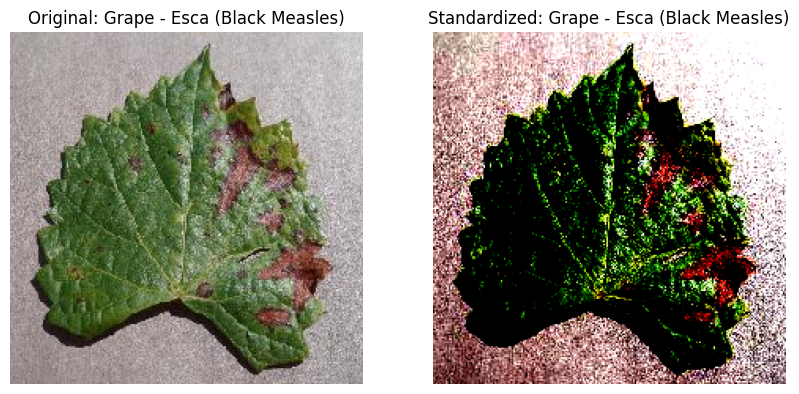

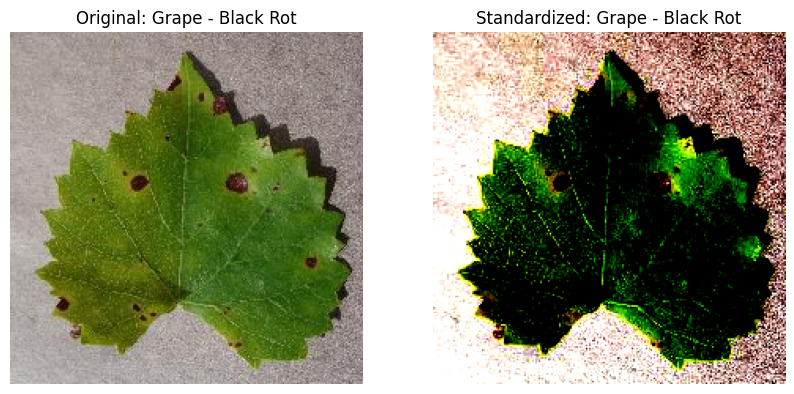

>>>> Sample Images of "Peach" dataset


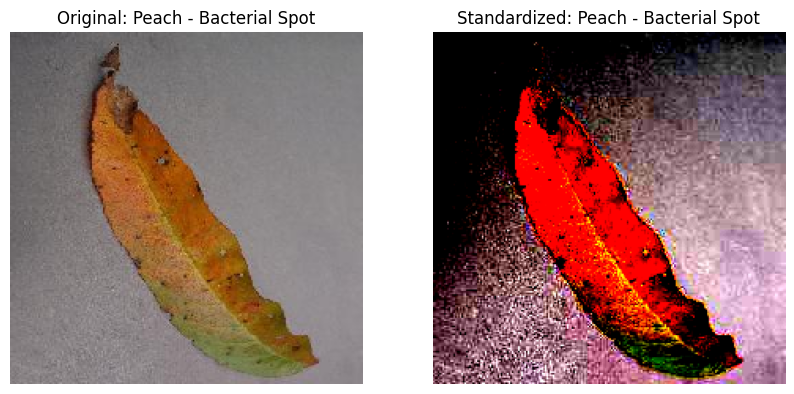

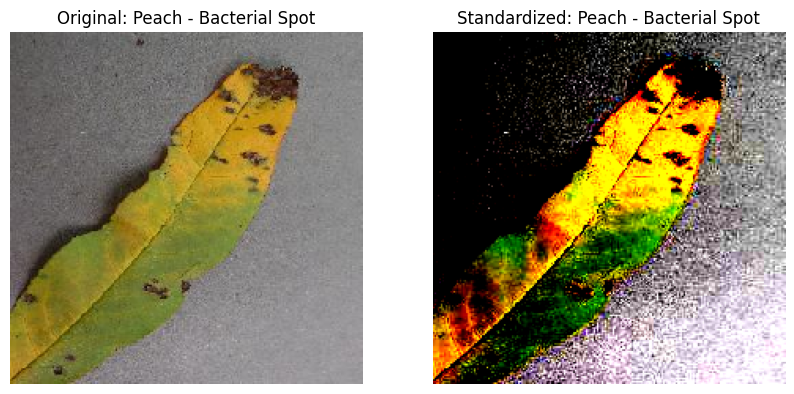

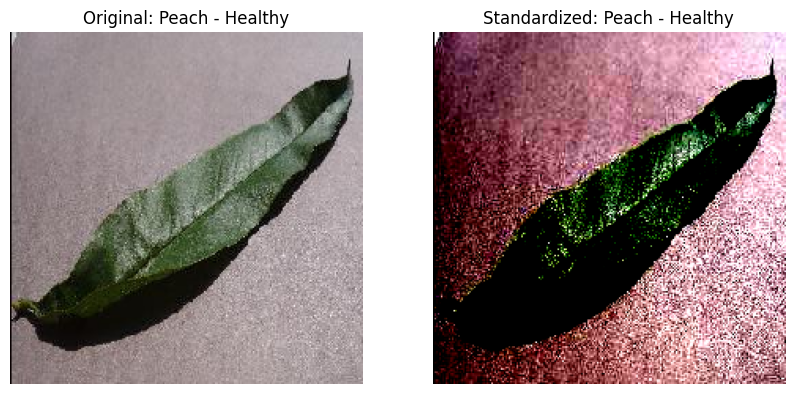

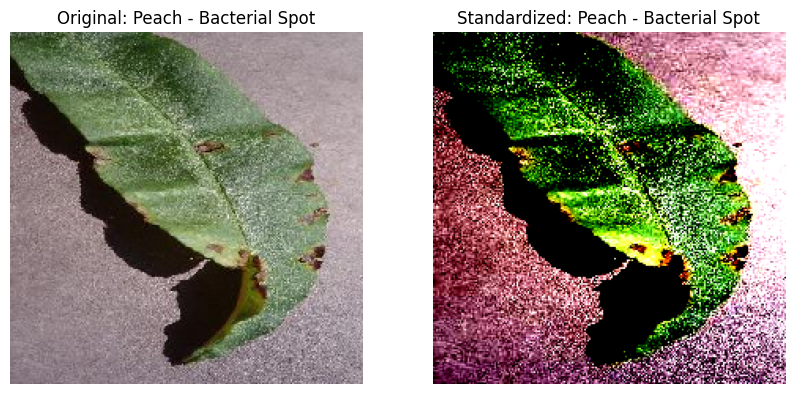

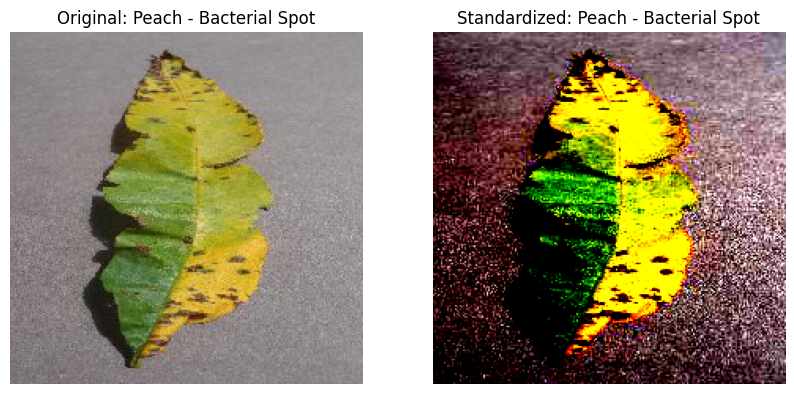

>>>> Sample Images of "Potato" dataset


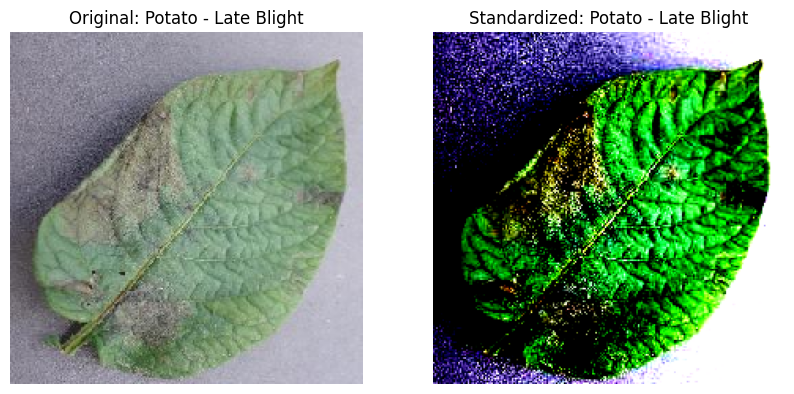

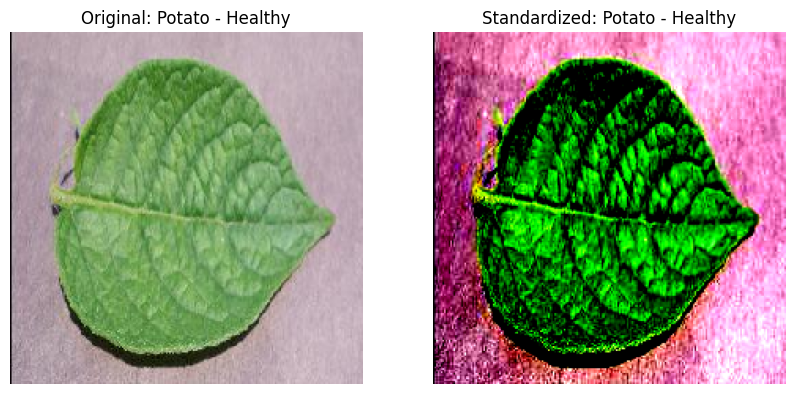

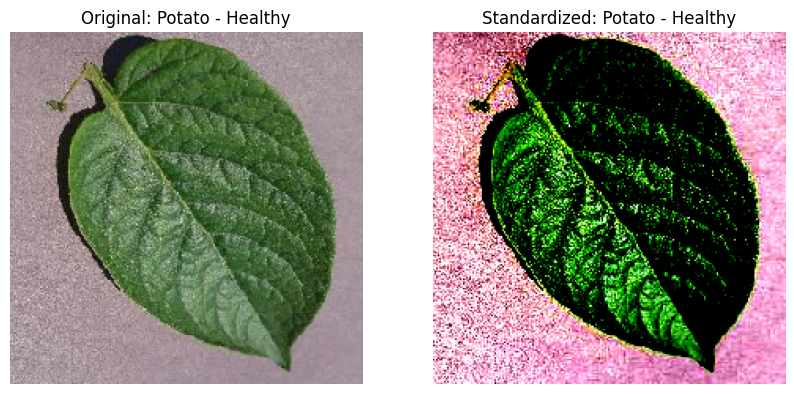

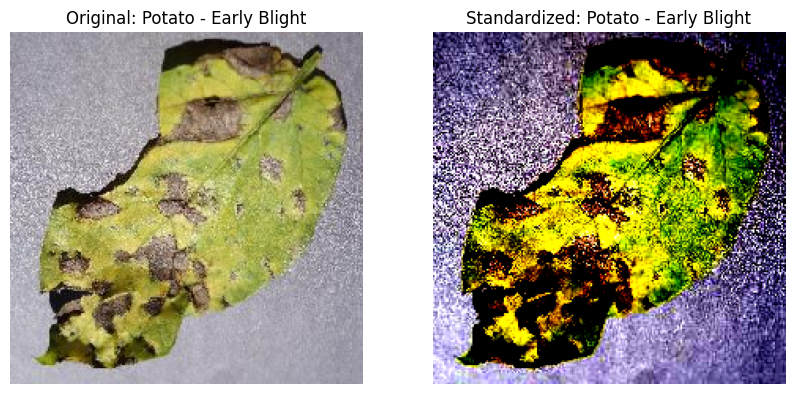

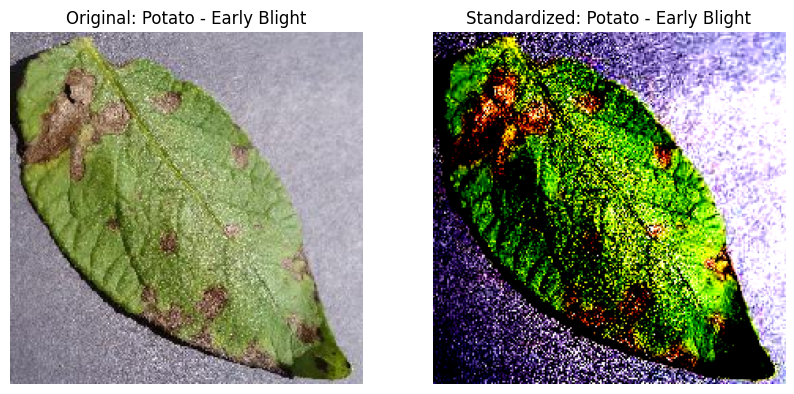

>>>> Sample Images of "Strawberry" dataset


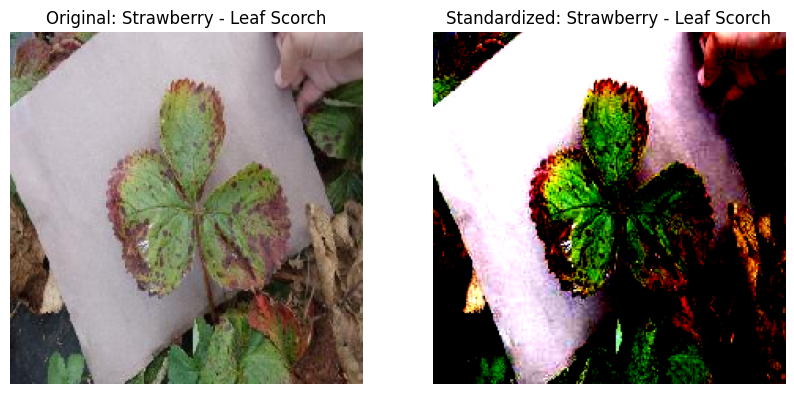

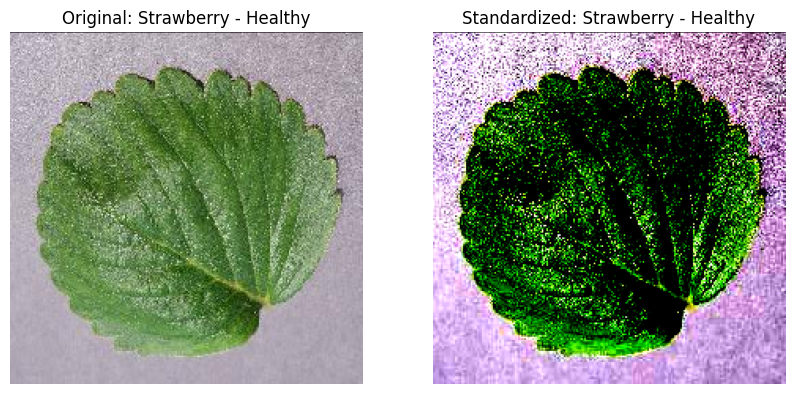

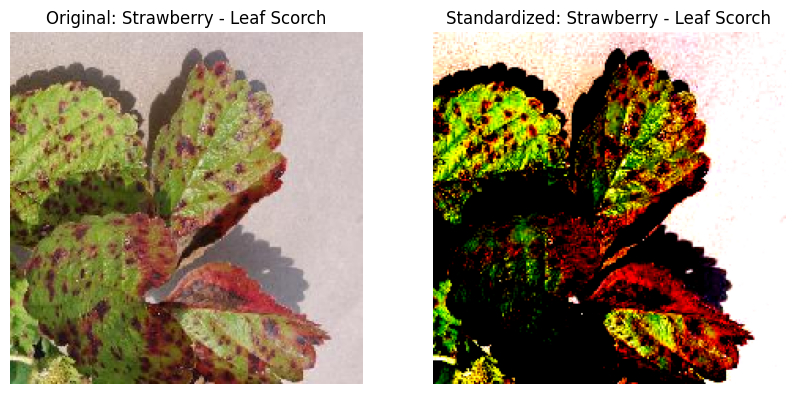

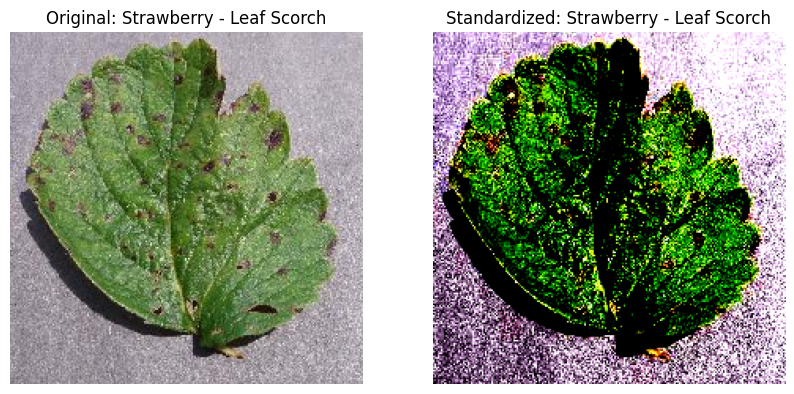

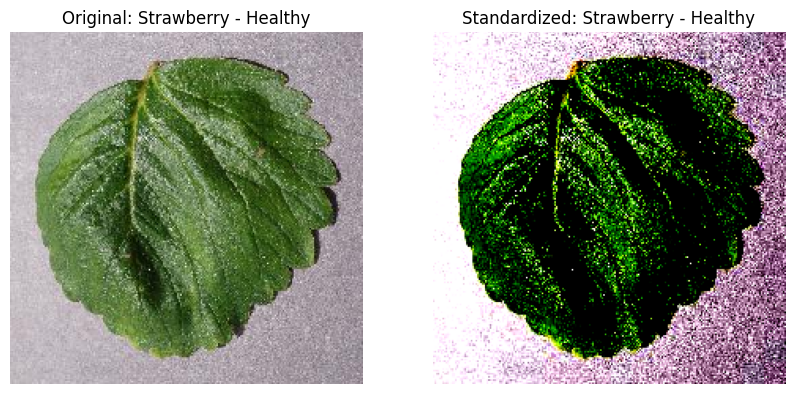

>>>> Sample Images of "Tomato" dataset


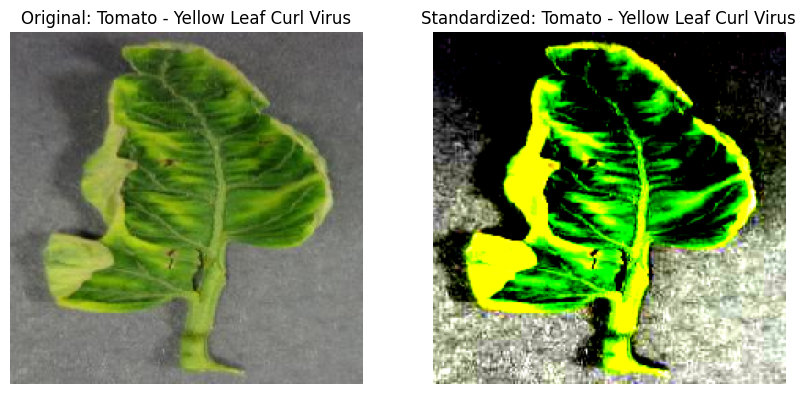

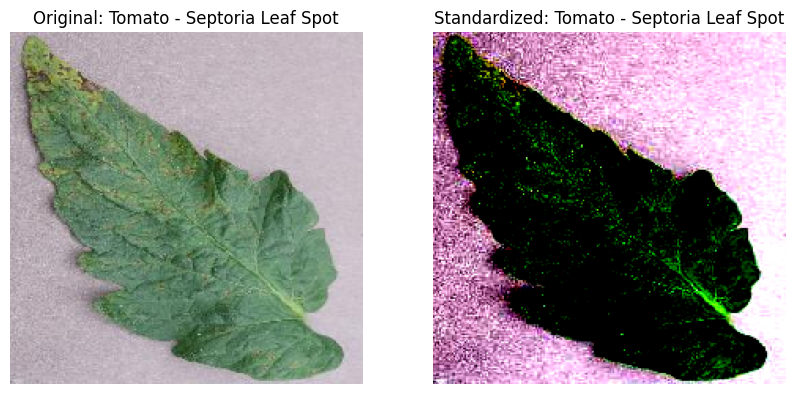

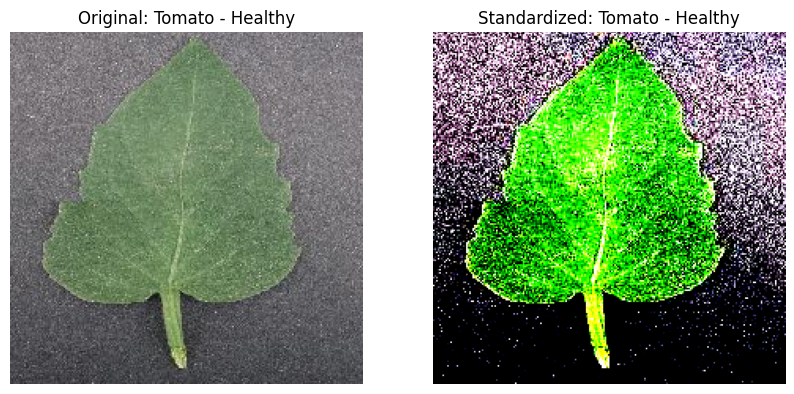

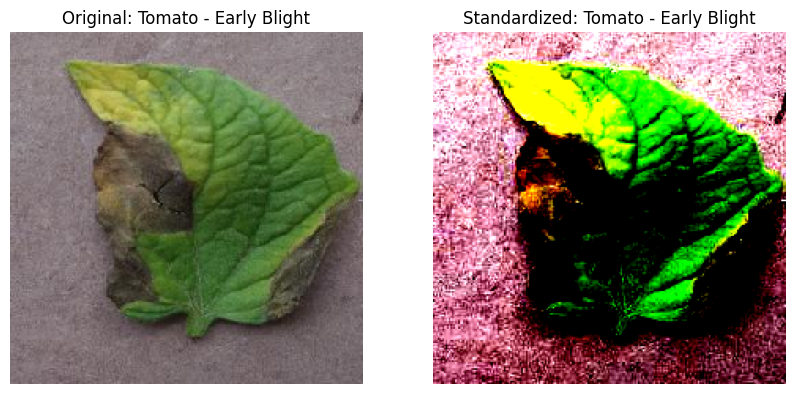

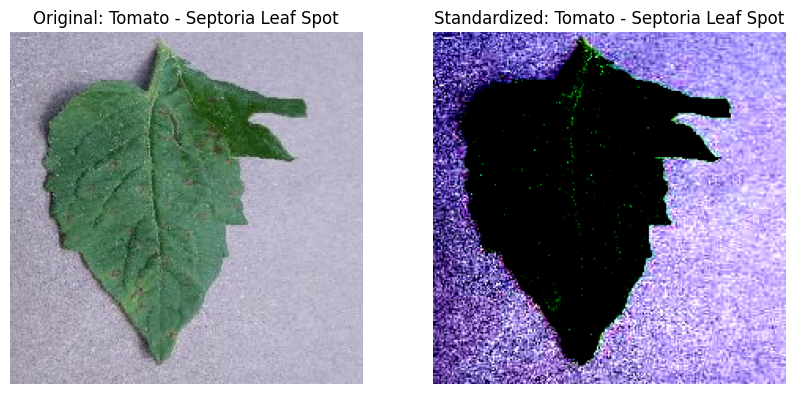

In [ ]:
# Define Plant Names and Directory Paths
plants = ['Apple', 'Bell Pepper', 'Cherry', 'Corn (Maize)', 'Grape', 'Peach', 'Potato', 'Strawberry', 'Tomato']
base_dir = '/content/drive/Shareddrives/Capstone/CapstoneNewData/'

# Create Data Generators
data_generators = {}
for plant in plants:
    train_dir = os.path.join(base_dir, plant, 'Train')

    if not os.path.isdir(train_dir):
        print(f"Skipping {plant} as train directory does not exist.")
        continue

    # Create the data generator for training images
    train_datagen = ImageDataGenerator(rescale=1./255)

    train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(224, 224),
        batch_size=32,
        class_mode='categorical',
        shuffle=True
    )

    data_generators[plant] = {'train': train_generator}

# Function to standardize images
def standardize_img(img):
    mean = np.mean(img, axis=(0, 1, 2), keepdims=True)
    std = np.std(img, axis=(0, 1, 2), keepdims=True)
    return (img - mean) / (std + 1e-7)  # Add epsilon to avoid division by zero

# Plot Original and Standardized Images with Labels
for plant in plants:
    if plant not in data_generators:
        continue

    print(f'>>>> Sample Images of "{plant}" dataset')

    train_generator = data_generators[plant]['train']
    class_indices = train_generator.class_indices  # Class indices (e.g., {'Apple Scab': 0, 'Healthy': 1})
    idx_to_class = {v: k for k, v in class_indices.items()}  # Reverse the dictionary to map indices to class names
    image_batch, image_label = next(train_generator)

    for i in range(5):  # Display first 5 images
        original_img = image_batch[i]  # Original image from the generator
        standardized_img = standardize_img(original_img)  # Standardized version of the image

        # Get the class index and class name
        class_index = np.argmax(image_label[i])  # Get the index of the predicted class
        class_name = idx_to_class[class_index]   # Get the class name from index

        plt.figure(figsize=(10, 5))

        # Plot original image
        plt.subplot(1, 2, 1)
        plt.imshow(original_img)
        plt.title(f"Original: {plant} - {class_name}")  # Include plant name and class name in title
        plt.axis('off')

        # Plot standardized image
        plt.subplot(1, 2, 2)
        plt.imshow(standardized_img)  # Display standardized image
        plt.title(f"Standardized: {plant} - {class_name}")  # Include plant name and class name in title
        plt.axis('off')

        plt.show()


This code block aims to traverse through each plant's data directory, count the total number of images across training, validation, and testing subdirectories, and then plot the results as a horizontal bar chart

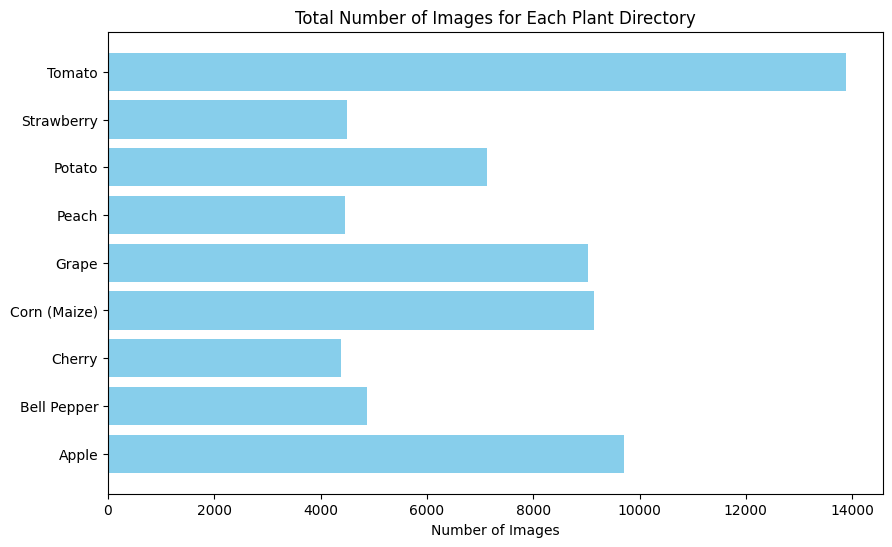

In [ ]:

plants = ['Apple', 'Bell Pepper', 'Cherry', 'Corn (Maize)', 'Grape', 'Peach', 'Potato', 'Strawberry', 'Tomato']
base_dir = '/content/drive/Shareddrives/Capstone/CapstoneNewData/'

# Image extensions to include
valid_extensions = ('.jpg', '.jpeg', '.png', '.JPG', '.JPEG', '.PNG')

# Dictionary to hold the total image count for each plant
plant_image_counts = {}

# Traverse through each plant directory
for plant in plants:
    total_images = 0  # Initialize total image count for this plant
    plant_dir = os.path.join(base_dir, plant)

    # Check if the plant directory exists
    if not os.path.isdir(plant_dir):
        print(f"Skipping {plant} as directory does not exist.")
        continue

    # Traverse through each subdirectory (Train, Val, Test)
    for subdir in ['Train', 'Val', 'Test']:
        subdir_path = os.path.join(plant_dir, subdir)

        # If the subdirectory exists, count the images
        if os.path.isdir(subdir_path):
            for root, dirs, files in os.walk(subdir_path):
                # Count valid image files based on the extensions
                images = [file for file in files if file.endswith(valid_extensions)]
                total_images += len(images)  # Add to total image count for this plant

    plant_image_counts[plant] = total_images  # Store the count for this plant

# Plotting the results
plants = list(plant_image_counts.keys())
image_counts = list(plant_image_counts.values())

plt.figure(figsize=(10, 6))
plt.barh(plants, image_counts, color='skyblue')
plt.xlabel('Number of Images')
plt.title('Total Number of Images for Each Plant Directory')
plt.show()


Let us visualize the number of diseases per plant directory using matplotlib

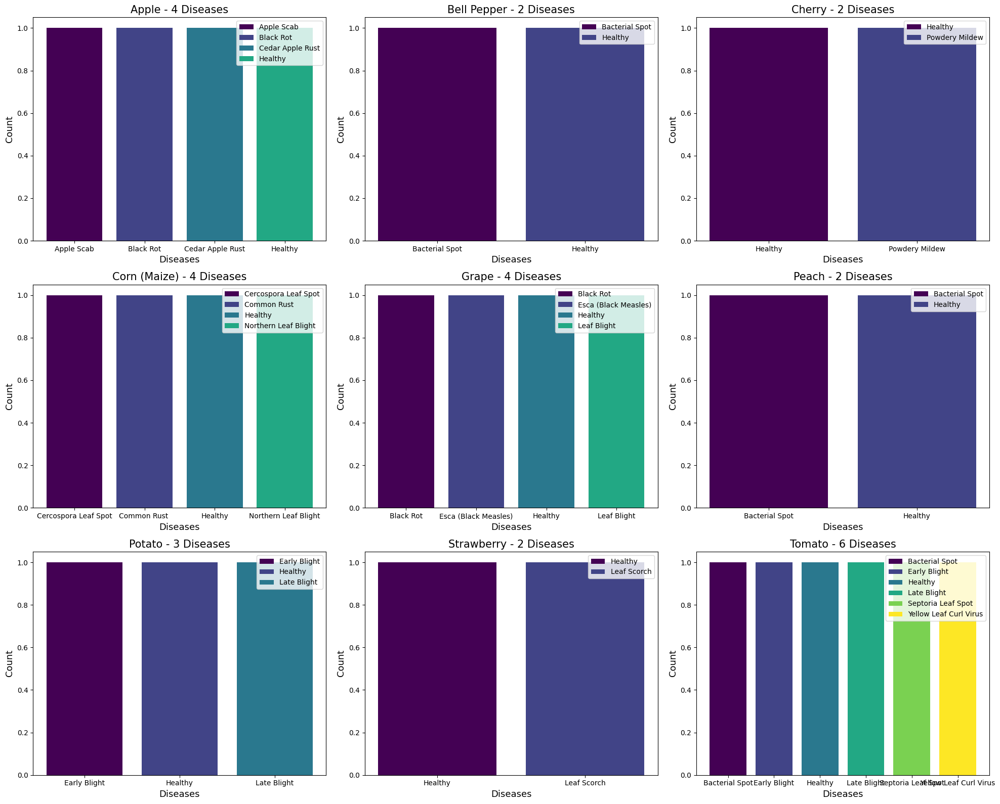

In [ ]:


# Define Plant Names and Directory Paths
plants = ['Apple', 'Bell Pepper', 'Cherry', 'Corn (Maize)', 'Grape', 'Peach', 'Potato', 'Strawberry', 'Tomato']
base_dir = '/content/drive/Shareddrives/Capstone/CapstoneNewData/'

# Dictionary to hold disease data for each plant
disease_data = {}

# Traverse through each plant directory and list distinct diseases
for plant in plants:
    plant_dir = os.path.join(base_dir, plant, 'Train')

    if os.path.isdir(plant_dir):
        diseases = [d for d in os.listdir(plant_dir) if os.path.isdir(os.path.join(plant_dir, d))]
        disease_data[plant] = diseases  # Store the list of diseases for each plant
    else:
        print(f"Skipping {plant} as directory does not exist.")

# Prepare data for plotting
x = [f"{plant} - {disease}" for plant, diseases in disease_data.items() for disease in diseases]  # Flatten plant and disease names
y = [len(disease_data[plant]) for plant in disease_data]  # Number of distinct diseases per plant

# Generate colors for the plots
colors = plt.cm.viridis(np.linspace(0, 1, max(len(diseases) for diseases in disease_data.values())))  # Color for each disease

# Plot setup
fig, axes = plt.subplots(3, 3, figsize=(20, 16))  # Create 3x3 grid for up to 9 plants
axes = axes.flatten()  # Flatten axes for easy iteration

# Plot bar charts for each plant's diseases
idx = 0
for plant, diseases in disease_data.items():
    disease_counts = [1] * len(diseases)  # We just want to count the distinct diseases, so each is counted once
    disease_colors = colors[:len(diseases)]  # Assign a color to each disease

    axes[idx].bar(diseases, disease_counts, color=disease_colors, label=diseases)
    axes[idx].set_xlabel('Diseases', fontsize=13)
    axes[idx].set_ylabel('Count', fontsize=13)
    axes[idx].set_title(f"{plant} - {len(diseases)} Diseases", fontsize=15)
    axes[idx].legend()
    idx += 1

# Remove extra subplots if there are fewer plants than subplots
for i in range(idx, 9):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()


## This code below takes a random image from a directory, resizes it, divides it into smaller patches (32x32), and visualizes each patch in a grid, overlaying each patch with a unique color for better distinction. The patch-based representation can help in tasks like classification or object detection.

Image size: 224 X 224
Patch size: 32 X 32
Patches per image: 49
Elements per patch: 3072


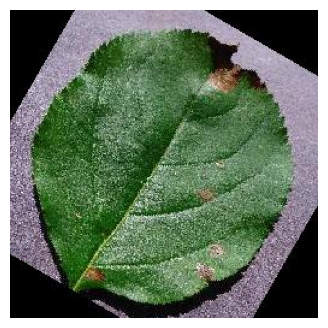

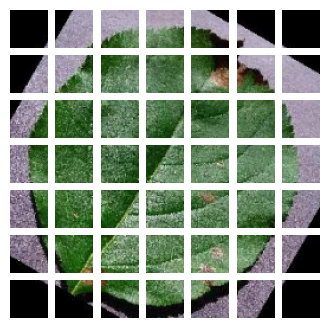

In [ ]:

# Image parameters
image_size = 224
img_height, img_width = 512, 512
patch_size = 32
num_patches = (image_size // patch_size) ** 2

# Define the Patches class
class Patches(layers.Layer):
    def __init__(self, patch_size):
        super(Patches, self).__init__()
        self.patch_size = patch_size

    def call(self, images):
        batch_size = tf.shape(images)[0]
        patches = tf.image.extract_patches(
            images=images,
            sizes=[1, self.patch_size, self.patch_size, 1],
            strides=[1, self.patch_size, self.patch_size, 1],
            rates=[1, 1, 1, 1],
            padding="VALID",
        )
        patch_dims = patches.shape[-1]
        patches = tf.reshape(patches, [batch_size, -1, patch_dims])
        return patches

# Directory Paths
base_dir = '/content/drive/Shareddrives/Capstone/CapstoneNewData/Apple/Train/Black Rot'
random_image_name = random.choice(os.listdir(base_dir))  # Select a random image
image_path = os.path.join(base_dir, random_image_name)   # Full path to the image

# Load and display the selected image
plt.figure(figsize=(4, 4))
image = mpimg.imread(image_path)
plt.imshow(image.astype("uint8"))
plt.axis("off")

# Resize the image to the target size
resized_image = tf.image.resize(
    tf.convert_to_tensor([image]), size=(image_size, image_size)
)

# Apply the Patches layer
patches = Patches(patch_size)(resized_image)

# Display information about the patches
print(f"Image size: {image_size} X {image_size}")
print(f"Patch size: {patch_size} X {patch_size}")
print(f"Patches per image: {patches.shape[1]}")
print(f"Elements per patch: {patches.shape[-1]}")

# Display the patches
n = int(np.sqrt(patches.shape[1]))  # Calculate grid size (n x n) to display patches
plt.figure(figsize=(4, 4))
for i, patch in enumerate(patches[0]):
    ax = plt.subplot(n, n, i + 1)
    patch_img = tf.reshape(patch, (patch_size, patch_size, 3))
    plt.imshow(patch_img.numpy().astype("uint8"))
    plt.axis("off")


# MODEL DEVELOPMENT

In [ ]:
plant = "Apple"

In [ ]:


train_path = f"/content/drive/Shareddrives/Capstone/CapstoneNewData/{plant}/Train"
val_path = f"/content/drive/Shareddrives/Capstone/CapstoneNewData/{plant}/Val"
test_path = f"/content/drive/Shareddrives/Capstone/CapstoneNewData/{plant}/Test"

# Get the list of output labels (diseases) in the Train directory
out_labels = os.listdir(train_path)
out_len = len(out_labels)  # Number of distinct labels




In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Parameters
batch_size = 64
img_height = 224
img_width = 224


plant = 'Apple'
train_path = f"/content/drive/Shareddrives/Capstone/CapstoneNewData/{plant}/Train"
val_path = f"/content/drive/Shareddrives/Capstone/CapstoneNewData/{plant}/Val"
test_path = f"/content/drive/Shareddrives/Capstone/CapstoneNewData/{plant}/Test"

# Data Generators for loading images with augmentation for training
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

val_datagen = ImageDataGenerator(rescale=1./255)  # Rescaling validation data without augmentation
test_datagen = ImageDataGenerator(rescale=1./255)  # Rescaling test data without augmentation

# Loading the images from directories using flow_from_directory
train_generator = train_datagen.flow_from_directory(
    train_path,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical'
)

val_generator = val_datagen.flow_from_directory(
    val_path,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical'
)

test_generator = test_datagen.flow_from_directory(
    test_path,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False  # Shuffle is False for test data to keep the order consistent
)

# Displaying a summary of the number of batches and images loaded
print(f"Train batches: {len(train_generator)}")
print(f"Validation batches: {len(val_generator)}")
print(f"Test batches: {len(test_generator)}")


Found 7771 images belonging to 4 classes.
Found 1747 images belonging to 4 classes.
Found 196 images belonging to 4 classes.
Train batches: 122
Validation batches: 28
Test batches: 4


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models

# Number of classes (update the path as per your dataset)
out_len = len(os.listdir(f"/content/drive/Shareddrives/Capstone/CapstoneNewData/Apple/Train"))  # Number of disease categories

# Define the CNN architecture
model = models.Sequential([
    # First convolutional block
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),  # 32 filters, 3x3 kernel
    layers.MaxPooling2D((2, 2)),  # Max pooling

    # Second convolutional block
    layers.Conv2D(64, (3, 3), activation='relu'),  # 64 filters
    layers.MaxPooling2D((2, 2)),

    # Third convolutional block
    layers.Conv2D(128, (3, 3), activation='relu'),  # 128 filters
    layers.MaxPooling2D((2, 2)),

    # Fourth convolutional block
    layers.Conv2D(128, (3, 3), activation='relu'),  # 128 filters
    layers.MaxPooling2D((2, 2)),

    # Flatten the feature map to a 1D vector
    layers.Flatten(),

    # Fully connected (dense) layers
    layers.Dense(512, activation='relu'),  # Dense layer with 512 units
    layers.Dropout(0.5),  # Dropout for regularization

    # Output layer for multi-class classification
    layers.Dense(out_len, activation='softmax')  # 'out_len' is the number of disease classes
])

# Compile the CNN model
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),  # Adam optimizer
              loss='categorical_crossentropy',  # Loss function for multi-class classification
              metrics=['accuracy'])  # Accuracy metric

# Print the model summary
model.summary()


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 222, 222, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 111, 111, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 109, 109, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 54, 54, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 52, 52, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 26, 26, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 24, 24, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 12, 12, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 18432)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 512)                 │       9,437,696 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 4)                   │           2,052 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 9,680,580 (36.93 MB)

 Trainable params: 9,680,580 (36.93 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# Train the CNN model
epochs = 10  # Set the number of epochs
history = model.fit(
    train_generator,  # Training data generator
    epochs=epochs,
    validation_data=val_generator,  # Validation data generator
    steps_per_epoch=len(train_generator),  # Number of steps per epoch
    validation_steps=len(val_generator)  # Number of validation steps
)

# Evaluate the model on the test set
test_loss, test_acc = model.evaluate(test_generator)
print(f"Test Accuracy: {test_acc:.2f}")


Epoch 1/10
122/122 ━━━━━━━━━━━━━━━━━━━━ 3391s 27s/step - accuracy: 0.4101 - loss: 1.2007 - val_accuracy: 0.7705 - val_loss: 0.5922
Epoch 2/10


AttributeError: 'NoneType' object has no attribute 'items'